# RGB segmentation

In [21]:
import maxrf4u as mx 
import zarr 
import dask 
import numpy as np
import os 
from glob import glob
import re
import matplotlib.pyplot as plt 
import dask.array as da 
import cv2 as cv

In [2]:
os.chdir('..') 
print(f'maxrf4u: {mx.__version__}')

maxrf4u: 0.1.42


In [4]:
datastack_files = glob('./data/interim/maxrf/datastacks/*.datastack')
for i, ds in enumerate(datastack_files):
    print(i, ds)

0 ./data/interim/maxrf/datastacks/WM-71803-01_400_600_50.datastack
1 ./data/interim/maxrf/datastacks/WM-71803-03_250_300_50.datastack
2 ./data/interim/maxrf/datastacks/WM-71803-08_250_300_50.datastack
3 ./data/interim/maxrf/datastacks/WM-71803-10_250_300_50.datastack
4 ./data/interim/maxrf/datastacks/WM-71803-12_250_300_50.datastack
5 ./data/interim/maxrf/datastacks/WM-71803-13_400_600_50.datastack
6 ./data/interim/maxrf/datastacks/WM-71803-17_400_600_50.datastack
7 ./data/interim/maxrf/datastacks/WM-71803-18_400_300_50_det.datastack
8 ./data/interim/maxrf/datastacks/WM-71803-18_400_500_50.datastack
9 ./data/interim/maxrf/datastacks/WM-71803-19_400_600_50.datastack
10 ./data/interim/maxrf/datastacks/WM-71803-23_400_600_50.datastack
11 ./data/interim/maxrf/datastacks/WM-71803-24_400_600_50.datastack
12 ./data/interim/maxrf/datastacks/WM-71803-29_400_500_50.datastack
13 ./data/interim/maxrf/datastacks/WM-71803-30_250_300_50.datastack
14 ./data/interim/maxrf/datastacks/WM-71803-31_400_600

In [5]:
%matplotlib widget

In [40]:
ds.tree()

/
├── compton_peak_energy (1,) float64
├── hotmax_baselines (31, 4096) float64
├── hotmax_noiselines (31, 4096) float64
├── hotmax_peak_idxs_flat (34,) int64
├── hotmax_peak_idxs_list (31, 2) int64
├── hotmax_spectra (31, 4096) float32
├── hotmax_spots (31, 2) int64
├── hotmax_subpeak_idxs_list (31, 18) int64
├── imvis_extent (4,) int64
├── imvis_reg (617, 357, 3) uint8
├── imvis_reg_highres (8256, 4777, 3) uint8
├── maxrf_cube (617, 357, 4096) float32
├── maxrf_energies (4096,) float64
├── maxrf_maxspectrum (4096,) float32
├── maxrf_sumspectrum (4096,) float64
├── nmf_atomnums (18,) int64
├── nmf_elementmaps (18, 617, 357) float32
├── nmf_gausscomponents (35, 4096) float32
├── nmf_peakmaps (35, 617, 357) float32
└── nmf_peaks2elements_matrix (18, 34) float32

./data/interim/maxrf/datastacks/WM-71803-35_400_500_50.datastack:




In [41]:
imvis_list = []
imvis_hr_list = []
extent_list = []
for datastack_file in datastack_files: 
    ds = mx.DataStack(datastack_file)
    im = ds.read('imvis_reg')
    im_hr = ds.read('imvis_reg_highres')
    extent = ds.read('imvis_extent')
    imvis_list.append(im)
    imvis_hr_list.append(im_hr)
    extent_list.append(extent)

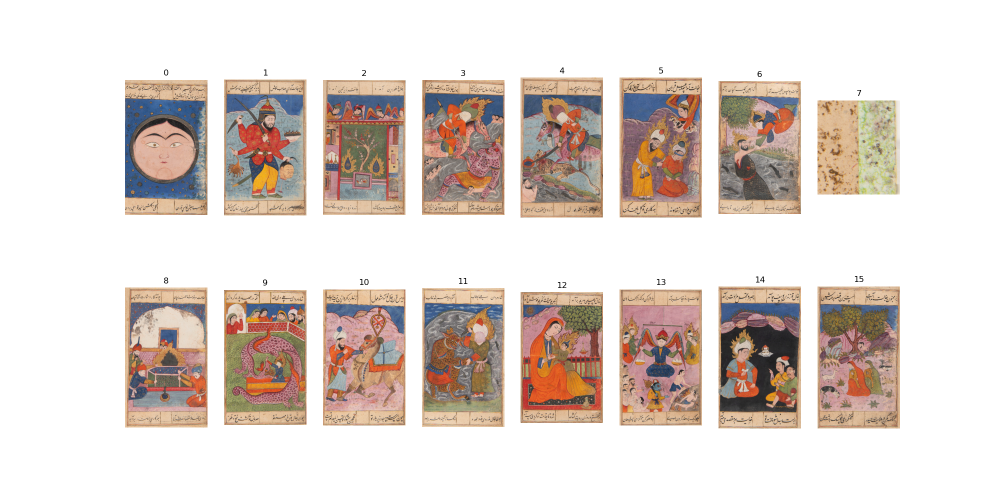

In [8]:
fig, axs = plt.subplots(ncols=8, nrows=2, figsize=[20, 10])
axs = axs.flatten()
for i, [im, ax, extent] in enumerate(zip(imvis_list, axs, extent_list)): 
    ax.imshow(im, extent=extent)
    ax.set_title(i)
    ax.set_axis_off()
    

In [9]:
# Authors: The scikit-learn developers
# SPDX-License-Identifier: BSD-3-Clause

import numpy as np

from sklearn.cluster import MeanShift, estimate_bandwidth
from sklearn.datasets import make_blobs

In [32]:
original = imvis_list[9]

In [63]:
#img = cv.medianBlur(original, 3)
img = original
# flatten the image
flat_image = img.reshape((-1,3))
flat_image = np.float32(flat_image)

# meanshift
bandwidth = estimate_bandwidth(flat_image, quantile=.01, n_samples=3000)
ms = MeanShift(bandwidth=bandwidth, max_iter=800, bin_seeding=True)
ms.fit(flat_image)
labeled=ms.labels_

# get number of segments
segments = np.unique(labeled)
print('Number of segments: ', segments.shape[0])

# get the average color of each segment
total = np.zeros((segments.shape[0], 3), dtype=float)
count = np.zeros(total.shape, dtype=float)
for i, label in enumerate(labeled):
    total[label] = total[label] + flat_image[i]
    count[label] += 1
avg = total/count
avg = np.uint8(avg)

# cast the labeled image into the corresponding average color
res = avg[labeled]
result = res.reshape((img.shape))
#result = cv.cvtColor(result, cv.COLOR_BGR2RGB)



Number of segments:  41


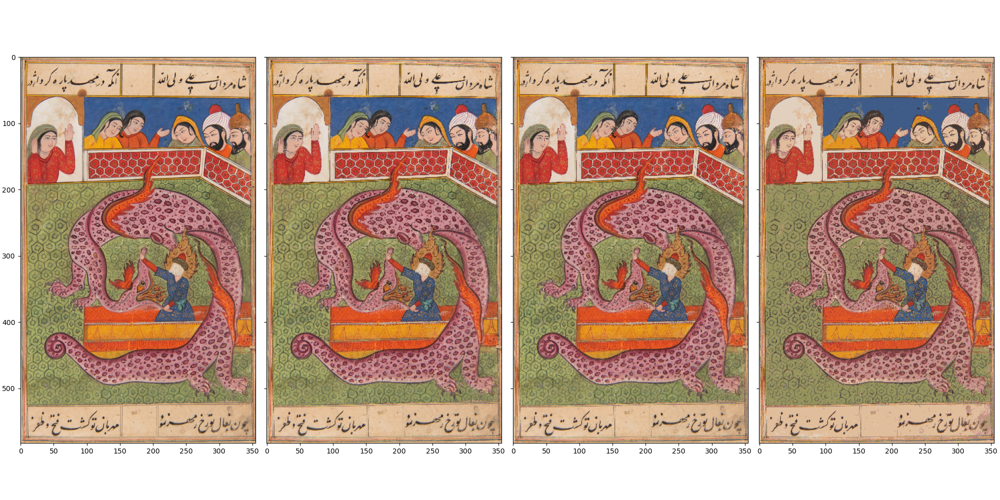

In [64]:
fig, axs = plt.subplots(ncols=4, figsize=(20, 10), layout='constrained', sharex=True, sharey=True)
ax, ax0, ax1, ax2 = axs.flatten()

ax.imshow(imvis_hr_list[9], extent=extent_list[9])
ax0.imshow(original)
ax1.imshow(img)
ax2.imshow(result)

In [90]:
counts = []
for l in np.arange(labeled.max()+1): 
    npix = np.sum(labeled == l)
    counts.append(npix)
counts = np.array(counts)

In [91]:
idxs = np.argsort(counts)[::-1]

counts_sorted = counts[idxs]
counts_sorted

array([35362, 34010, 20912, 15047,  9265,  8780,  7918,  7872,  7618,
        7193,  6093,  5557,  5523,  5317,  4923,  4514,  3466,  3187,
        3150,  3073,  1632,  1266,  1037,   731,   613,   546,   470,
         345,   316,   255,   222,   189,   134,   118,    77,    61,
          61,    55,    27,    20,    10])

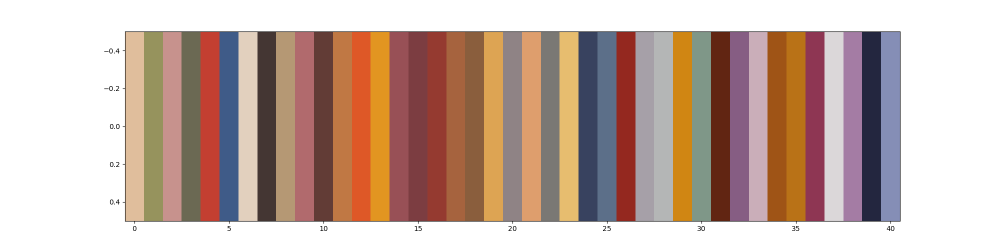

In [85]:
fig, ax =plt.subplots(figsize=[20, 5])
ax.imshow(avg[idxs].reshape(1, 41, 3), aspect=10)

In [92]:
idxs

array([ 0,  1,  2, 19,  4,  3,  5,  7, 15,  9, 12, 13,  6,  8, 11, 10, 14,
       16, 17, 18, 21, 25, 20, 34, 33, 22, 32, 29, 28, 24, 23, 39, 30, 27,
       31, 26, 37, 35, 36, 40, 38])

In [80]:
avg[idxs].shape

(41, 3)

In [81]:
avg.shape

(41, 3)

In [72]:
original.shape

(583, 355, 3)

In [47]:
labeled_im = labeled.reshape(original.shape[0:2])
labeled_im.shape

(583, 355)

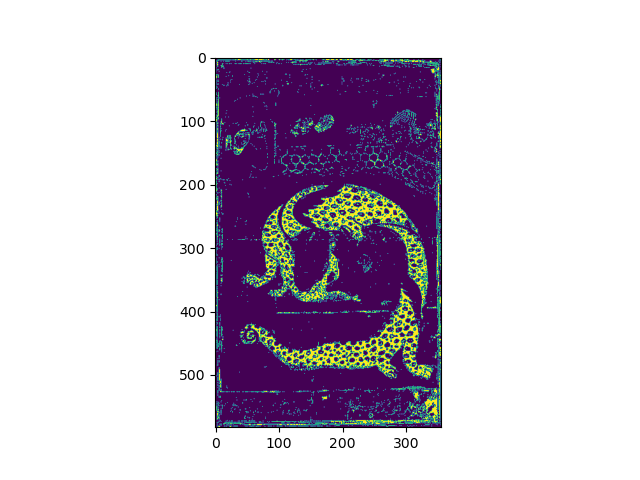

In [51]:
fig, ax = plt.subplots()
ax.imshow(labeled_im == 2)

In [18]:
ms.fit(im_list)

KeyboardInterrupt: 